# Timeline of CNNs

* [[2012] AlexNet](#alex-net)
* [[2014] VGG](#vgg)
* [[2014] InceptionNet/GoogleNet](#inception-net)
* [[2015] ResNet](#res-net)
* [[2016] ResNeXt](#res-next)
* [[2017] Xception](#xception)
* [[2017] DenseNet](#dense-net)
* [[2017] MobileNetV1](#mobile-net-v1)
* [[2018] MobileNetV2](#mobile-net-v2)
* [[2019] EfficientNet](#efficient-net)
* [[2020] RegNet](#reg-net)
* [[2022] ConvMixer](#conv-mixer)
* [[2022] ConvNext](#conv-next)

In [1]:
import tensorflow as tf
from tensorflow.keras import layers, utils

import tensorflow_addons as tfa

# AlexNet <span id="alex-net">[2012]</span>

[ImageNet Classification with Deep Convolutional Neural Networks](https://proceedings.neurips.cc/paper/2012/file/c399862d3b9d6b76c8436e924a68c45b-Paper.pdf)

AlexNet was the first architecture that employed max-pooling layers, ReLu activation functions, and dropout regularization technique. Up to day, dropout is one of the most effective regularization technique.

2022-03-25 06:01:57.602184: I tensorflow/core/common_runtime/process_util.cc:146] Creating new thread pool with default inter op setting: 2. Tune using inter_op_parallelism_threads for best performance.


Model: "alexnet"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 54, 54, 96)        34944     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 27, 27, 96)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 27, 27, 256)       614656    
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 13, 13, 256)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 13, 13, 384)       885120    
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 13, 13, 384)       1327488   
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 13, 13, 256)       8849

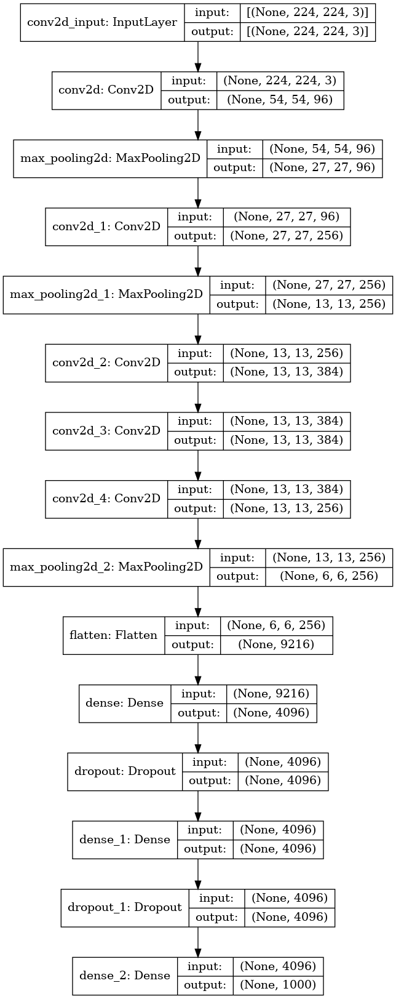

In [2]:
tf.keras.backend.clear_session()

alexnet = tf.keras.models.Sequential(
    [
        layers.Conv2D(filters=96, kernel_size=(11, 11), strides=4, activation="relu", input_shape=(224, 224, 3)),
        layers.MaxPooling2D(pool_size=(3, 3), strides=2, padding="same"),
        layers.Conv2D(filters=256, kernel_size=(5, 5), padding="same", activation="relu"),
        layers.MaxPooling2D(pool_size=(3, 3), strides=2),
        layers.Conv2D(filters=384, kernel_size=(3, 3), padding="same", activation="relu"),
        layers.Conv2D(filters=384, kernel_size=(3, 3), padding="same", activation="relu"),
        layers.Conv2D(filters=256, kernel_size=(3, 3), padding="same", activation="relu"),
        layers.MaxPooling2D(pool_size=(3, 3), strides=2),
        layers.Flatten(),
        # Fully connected layers
        layers.Dense(units=4096, activation="relu"),
        layers.Dropout(0.5),
        layers.Dense(units=4096, activation="relu"),
        layers.Dropout(0.5),
        # Units in last layer are 1000 per imagenet dataset
        layers.Dense(units=1000, activation="softmax"),
    ], name="alexnet"
)
alexnet.summary()
utils.plot_model(alexnet, show_shapes=True, to_file="alexnet.png")

# VGG <span id="vgg">[2014]</span>

[Very Deep Convolutional Networks For Large-Scale Image Recognition](https://arxiv.org/pdf/1409.1556.pdf)

Visual Geometry Group(VGG) introduced new principles for designing ConvNets (some of which are still norms to day)

The main principle is that a stack of three 3×3 conv. layers are similar to a single 7×7 layer. And maybe even better! Because they use three non-linear activations in between (instead of one), which makes the function more discriminative.

Secondly, this design decreases the number of parameters. Specifically, you need 3*(3^2)C^2 = 27C^2 weights, compared to a 7×7 conv. layer that would require 1*(7^2)C^2 = 49C^2 parameters (81% more).

Intuitively, it can be regarded as a regularisation on the 7×7 conv. filters, constricting them to have a 3x3 non-linear decomposition.

Finally, it was the first architecture that normalization started to become quite an issue.

Model: "vgg_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
pool1 (MaxPooling2D)         (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
pool2 (MaxPooling2D)         (None, 56, 56, 128)       0    

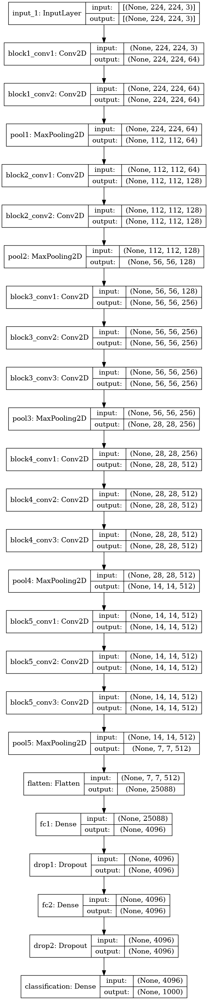

In [3]:
tf.keras.backend.clear_session()

## VGG-16

inputs = tf.keras.Input(shape=(224, 224, 3))

# Convolutional Block 1
"""
2 Convolutional layers: 64 filters each, same padding, relu activation
1 Maxpooling layer: pool size of 2, stride of 2
"""
x = layers.Conv2D(filters=64, kernel_size=(3, 3), padding="same", activation="relu", name="block1_conv1")(inputs)
x = layers.Conv2D(filters=64, kernel_size=(3, 3), padding="same", activation="relu", name="block1_conv2")(x)
block1_end = layers.MaxPooling2D(pool_size=2, strides=2, name="pool1")(x)

# Convolutional Block 2
"""
2 Convolutional layers: 128 filters each, same padding, relu activation
1 Maxpooling layer: pool size of 2, stride of 2
"""
x = layers.Conv2D(filters=128, kernel_size=(3, 3), padding="same", activation="relu", name="block2_conv1")(block1_end)
x = layers.Conv2D(filters=128, kernel_size=(3, 3), padding="same", activation="relu", name="block2_conv2")(x)
block2_end = layers.MaxPooling2D(pool_size=2, strides=2, name="pool2")(x)


# Convolutional Block 3
"""
3 Convolutional layers: 256 filters each, same padding, relu activation
1 Maxpooling layer: pool size of 2, stride of 2
"""
x = layers.Conv2D(filters=256, kernel_size=(3, 3), padding="same", activation="relu", name="block3_conv1")(block2_end)
x = layers.Conv2D(filters=256, kernel_size=(3, 3), padding="same", activation="relu", name="block3_conv2")(x)
x = layers.Conv2D(filters=256, kernel_size=(3, 3), padding="same", activation="relu", name="block3_conv3")(x)
block3_end = layers.MaxPooling2D(pool_size=2, strides=2, name="pool3")(x)


# Convolutional Block 4
"""
3 Convolutional layers: 512 filters each, same padding, relu activation
1 Maxpooling layer: pool size of 2, stride of 2
"""
x = layers.Conv2D(filters=512, kernel_size=(3, 3), padding="same", activation="relu", name="block4_conv1")(block3_end)
x = layers.Conv2D(filters=512, kernel_size=(3, 3), padding="same", activation="relu", name="block4_conv2")(x)
x = layers.Conv2D(filters=512, kernel_size=(3, 3), padding="same", activation="relu", name="block4_conv3")(x)
block4_end = layers.MaxPooling2D(pool_size=2, strides=2, name="pool4")(x)


# Convolutional Block 5
"""
3 Convolutional layers: 512 filters each, same padding, relu activation
1 Maxpooling layer: pool size of 2, stride of 2
"""
x = layers.Conv2D(filters=512, kernel_size=(3, 3), padding="same", activation="relu", name="block5_conv1")(block4_end)
x = layers.Conv2D(filters=512, kernel_size=(3, 3), padding="same", activation="relu", name="block5_conv2")(x)
x = layers.Conv2D(filters=512, kernel_size=(3, 3), padding="same", activation="relu", name="block5_conv3")(x)
block5_end = layers.MaxPooling2D(pool_size=2, strides=2, name="pool5")(x)

# Flattening layer

x = layers.Flatten(name="flatten")(block5_end)

# Fully connected layers
"""
2 fully connected layers of 4096 each
A dropout layer with 0.5 probability after above each fully connected layer
1 classification layer of 1000 units per imagenet with softmax activation
"""

x = layers.Dense(units=4096, activation="relu", name="fc1")(x)
x = layers.Dropout(0.5, name="drop1")(x)
x = layers.Dense(units=4096, activation="relu", name="fc2")(x)
x = layers.Dropout(0.5, name="drop2")(x)
outputs = layers.Dense(units=1000, activation="softmax", name="classification")(x)

# Create a model

vgg_16 = tf.keras.Model(inputs=inputs, outputs=outputs, name="vgg_16")

vgg_16.summary()
utils.plot_model(vgg_16, show_shapes=True, to_file="vgg_16.png")

# InceptionNet <span id="inception-net">[2012]</span>

[Going Deeper with Convolutions](https://arxiv.org/pdf/1409.4842.pdf)

InceptionNet demonstated that Increasing the depth (number of layers) is not the only way to make a model bigger. We can increase both the depth and width of the network while keeping computations to a constant level.

This time the inspiration comes from the human visual system, wherein information is processed at multiple scales and then aggregated locally.

The answer is with 1×1 convolutions! The main purpose is dimension reduction, by reducing the output channels of each convolution block. Then we can process the input with different kernel sizes. As long as the output is padded, it is the same as in the input.

Later on, in the paper “Rethinking the Inception Architecture for Computer Vision” the authors improved the Inception model based on the following principles:
* Factorize 5x5 and 7x7 (in InceptionV3) convolutions to two and three 3x3 sequential convolutions respectively. This improves computational speed. This is the same principle as VGG.
* They used spatially separable convolutions. Simply, a 3x3 kernel is decomposed into two smaller ones: a 1x3 and a 3x1 kernel, which are applied sequentially.
* The inception modules became wider (more feature maps).
* They tried to distribute the computational budget in a balanced way between the depth and width of the network.
* They added batch normalization.

Model: "inception_module"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
Input (InputLayer)              [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 224, 224, 6)  24          Input[0][0]                      
__________________________________________________________________________________________________
conv2d_3 (Conv2D)               (None, 224, 224, 6)  24          Input[0][0]                      
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 224, 224, 3)  0           Input[0][0]                      
___________________________________________________________________________________

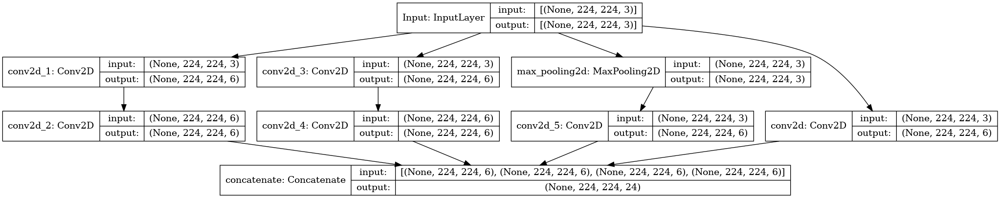

In [4]:
def inception_module(prev, c1, c2, c3, c4):
    """
    prev: previous layer
    c1, c2, c3, c4 are channels/number of filters for 4 parallel paths
    c1: channels for path 1
    c2: a tuple of two channels for path 2
    c3: a tuple of two channels for path 3
    c4: channels for path 1
    """

    # Path 1: 1x1 convolution, c1 channels
    p1 = layers.Conv2D(filters=c1, kernel_size=(1, 1), activation="relu")(prev)

    # Path 2: 1x1 convolution with channel c2[0], 3x3 convolution with channel c2[1]
    p2 = layers.Conv2D(filters=c2[0], kernel_size=(1, 1), activation="relu")(prev)
    p2 = layers.Conv2D(c2[1], kernel_size=(3, 3), activation="relu", padding="same")(p2)

    # Path 3: 1x1 convolution with channel c3[0], 5x5 convolution with channel c3[1]
    p3 = layers.Conv2D(filters=c3[0], kernel_size=(1, 1), activation="relu")(prev)
    p3 = layers.Conv2D(filters=c3[1], kernel_size=(5, 5), activation="relu", padding="same")(p3)

    # Path 4: maxpooling layer with 3x3 pool size and stride of 1, 1x1 convolution with c4 channels
    p4 = layers.MaxPool2D(pool_size=(3, 3), strides=1, padding="same")(prev)
    p4 = layers.Conv2D(filters=c4, kernel_size=(1, 1), activation="relu")(p4)

    # Concatenate the outputs of all 4 paths
    output = layers.Concatenate()([p1, p2, p3, p4])

    return output

tf.keras.backend.clear_session()

inputs = layers.Input(shape=[224,224,3], name='Input')
outputs = inception_module(inputs, 6, (6,6), (6,6), 6)

inception = tf.keras.Model(inputs, outputs, name="inception_module")


inception.summary()
utils.plot_model(inception, show_shapes=True, to_file="inception_module.png")

Model: "googlenet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 112, 112, 64) 9472        input_1[0][0]                    
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 56, 56, 64)   0           conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 56, 56, 64)   4160        max_pooling2d[0][0]              
__________________________________________________________________________________________

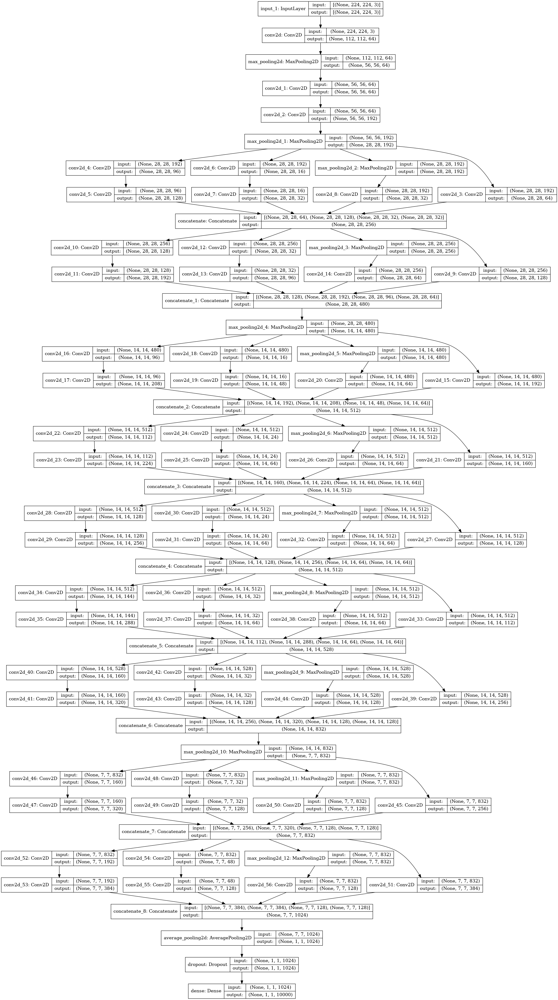

In [5]:
tf.keras.backend.clear_session()

## GoogLeNet

# Input and stem block
# Input shape: 224,224,3
# 7x7 convolution, 3x3 maxpool, 3x3 convolution, 3x3 maxpool


inputs = layers.Input(shape=[224,224,3])
x = layers.Conv2D(filters=64, kernel_size=(7,7), strides=2, padding='same', activation='relu')(inputs)
x = layers.MaxPool2D(pool_size=(3,3), strides=2, padding='same')(x)
x = layers.Conv2D(filters=64, kernel_size=(1,1), activation='relu')(x)
x = layers.Conv2D(filters=192, kernel_size=(3,3), padding='same', activation='relu')(x)
x = layers.MaxPool2D(pool_size=(3,3), strides=2, padding='same')(x)

### Two inception modules and maxpool
x = inception_module(x, 64, (96, 128), (16, 32), 32)
x = inception_module(x, 128, (128, 192), (32, 96), 64)
x = layers.MaxPool2D(pool_size=(3,3), strides=2, padding='same')(x)

### Five inception modules and maxpool
x = inception_module(x, 192, (96, 208), (16, 48), 64)
x = inception_module(x, 160, (112, 224), (24, 64), 64)
x = inception_module(x, 128, (128, 256), (24, 64), 64)
x = inception_module(x, 112, (144, 288), (32, 64), 64)
x = inception_module(x, 256, (160, 320), (32, 128), 128)
x = layers.MaxPool2D(pool_size=(3,3), strides=2, padding='same')(x)

### Two Inception modules and average pooling layer
x = inception_module(x, 256, (160, 320), (32, 128), 128)
x = inception_module(x, 384, (192, 384), (48, 128), 128)
x = layers.AveragePooling2D(pool_size=(7,7))(x)

### Dropout & classification head

x = layers.Dropout(0.4)(x)
outputs = layers.Dense(units=10000, activation='softmax')(x)

googlenet = tf.keras.Model(inputs, outputs, name="googlenet")


googlenet.summary()
utils.plot_model(googlenet, show_shapes=True, to_file="googlenet.png")

# ResNet <span id="res-net">[2015]</span>

[Deep Residual Learning for Image Recognition](https://arxiv.org/pdf/1512.03385.pdf)

Instead of H(x) = F(x), we ask them model to learn the difference (residual) H’(x) = F(x) + x, which means H(x) - x = F(x) will be the residual part.

With that simple but yet effective block, the authors designed deeper architectures ranging from 18 (Resnet-18) to 150 (Resnet-150) layers. For the deepest models they adopted 1x1 convs.

Model: "identity_block"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 112, 112, 256 37888       input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 112, 112, 64) 16448       conv2d[0][0]                     
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 112, 112, 64) 256         conv2d_1[0][0]                   
_____________________________________________________________________________________

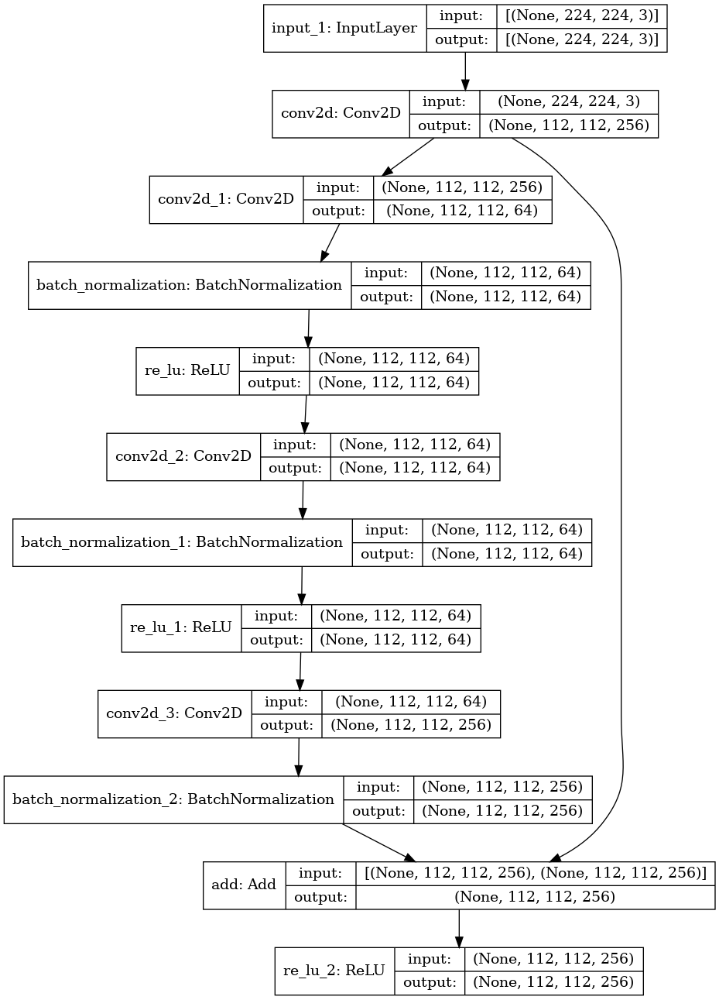

In [6]:
def identity_block(input_tensor, filters, strides=1):
    """
    input tensor
    filters: a tuple of 3 filters to be used in convolutional layers
    strides = 1 for all conv layers
    """
    f1, f2, f3 = filters

    x = layers.Conv2D(filters=f1, kernel_size=(1, 1), strides=strides)(input_tensor)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv2D(filters=f2, kernel_size=(3, 3), strides=strides, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv2D(filters=f3, kernel_size=(1, 1), strides=strides)(x)
    x = layers.BatchNormalization()(x)

    x = layers.Add()([x, input_tensor])
    output_tensor = layers.ReLU()(x)

    return output_tensor


tf.keras.backend.clear_session()

inputs = layers.Input(shape=(224, 224, 3))
x = layers.Conv2D(filters=256, kernel_size=(7,7), strides=2, padding='same')(inputs)
outputs = identity_block(x, (64, 64, 256))
identity_block_ = tf.keras.Model(inputs, outputs, name="identity_block")

identity_block_.summary()
utils.plot_model(identity_block_, show_shapes=True, to_file="identity_block.png")

Model: "projection_block"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 112, 112, 64) 256         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 112, 112, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
re_lu (ReLU)                    (None, 112, 112, 64) 0           batch_normalization[0][0]        
___________________________________________________________________________________

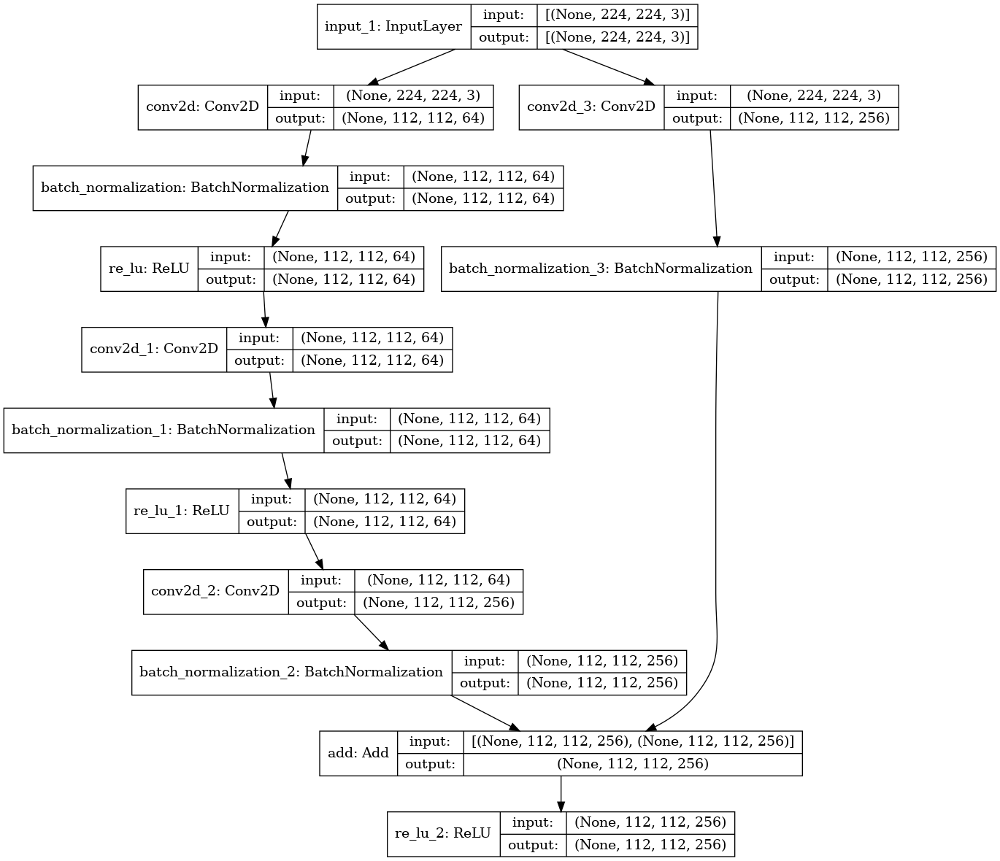

In [7]:
def projection_block(input_tensor, filters, strides=2):
    """
    A projection block is a block that has 1x1 conv layer in the shortcut connection
    1x1 convolution at shortcut connection is used for increasing the input dimension.
    input_tensor: input tensor
    filters: a tuple of 3 filters to be used in 3 conv layers at the main path, the 1x1conv shortcut takes third filter
    strides of 2 at the first conv layers in conv block conv3_1, conv4_1, and conv5_1 for downsampling purpose
    """

    f1, f2, f3 = filters
    x = layers.Conv2D(filters=f1, kernel_size=(1, 1), strides=strides)(input_tensor)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv2D(filters=f2, kernel_size=(3, 3), strides=1, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv2D(filters=f3, kernel_size=(1, 1), strides=1)(x)
    x = layers.BatchNormalization()(x)

    # 1x1 conv projection shortcut
    shortcut = layers.Conv2D(filters=f3, kernel_size=(1, 1), strides=strides)(input_tensor)
    shortcut = layers.BatchNormalization()(shortcut)

    x = layers.Add()([x, shortcut])
    output_tensor = layers.ReLU()(x)

    return output_tensor

tf.keras.backend.clear_session()

inputs = layers.Input(shape=(224, 224, 3))
outputs = projection_block(inputs, (64, 64, 256))
projection_block_ = tf.keras.Model(inputs, outputs, name="projection_block")

projection_block_.summary()
utils.plot_model(projection_block_, show_shapes=True, to_file="projection_block.png")

Model: "resnet_50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 112, 112, 64) 9472        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 112, 112, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
re_lu (ReLU)                    (None, 112, 112, 64) 0           batch_normalization[0][0]        
__________________________________________________________________________________________

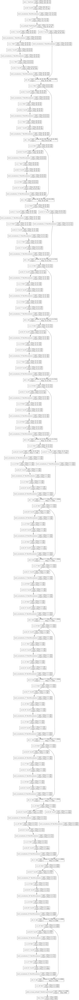

In [8]:
tf.keras.backend.clear_session()

inputs = layers.Input(shape=(224, 224, 3))

x = layers.Conv2D(filters=64, kernel_size=(7, 7), strides=2, padding="same")(inputs)
x = layers.BatchNormalization()(x)
x = layers.ReLU()(x)
x = layers.MaxPool2D(pool_size=3, strides=2, padding="same")(x)

x = projection_block(x, (64, 64, 256))
x = identity_block(x, (64, 64, 256))
x = identity_block(x, (64, 64, 256))

x = projection_block(x, (128, 128, 512))
x = identity_block(x, (128, 128, 512))
x = identity_block(x, (128, 128, 512))
x = identity_block(x, (128, 128, 512))

x = projection_block(x, (256, 256, 1024))
x = identity_block(x, (256, 256, 1024))
x = identity_block(x, (256, 256, 1024))
x = identity_block(x, (256, 256, 1024))
x = identity_block(x, (256, 256, 1024))
x = identity_block(x, (256, 256, 1024))

x = projection_block(x, (512, 512, 2048))
x = identity_block(x, (512, 512, 2048))
x = identity_block(x, (512, 512, 2048))

x = layers.GlobalAvgPool2D()(x)
outputs = layers.Dense(1000, activation="softmax")(x)

resnet50 = tf.keras.Model(inputs, outputs, name="resnet_50")

resnet50.summary()
utils.plot_model(resnet50, show_shapes=True, to_file="resnet50.png")

# ResNeXt <span id="res-next">[2016]</span>

[Aggregated Residual Transformations for Deep Neural Networks](https://arxiv.org/pdf/1611.05431v2.pdf)

ResNeXt is an improved or modularized version of ResNet.

It follows the following design rules:

* The residual blocks that produces the spatial maps of the same size should have the same width and filter sizes.
* Everytime the spatial map is downsampled by a factor of 2, the width of the residual block is also multiplied by a factor of 2. This idea preserves the same computational complexity in terms of FLOPS(floaping point operations).

To improve the performance while maintaining low computational complexity, ResNeXt makes use of grouped convolutions. Grouped convolutions are special kind of convolutions where the input and output channels are divided into parallel groups, and convolutions are separately computed within each group and the results are concatenated. If the number of groups are equal to the number of channels, such grouped convolutions are called depth-wise convolution. A depth-wise convolution followed by 1x1 or pointwise convolution is called depth-wise separable convolution.

In [9]:
def identity_block(inputs, dim):
    """
    input: input tensor
    dim: channel dimension of conv_layers
    """

    shortcut = inputs

    x = layers.Conv2D(filters=dim, kernel_size=1)(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv2D(filters=dim, kernel_size=3, groups=32, padding='same')(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv2D(filters=dim*2, kernel_size=1)(x)
    x = layers.BatchNormalization()(x)

    output = layers.Add()([shortcut, x])
    output = layers.Activation('relu')(output)

    return output


def projection_block(inputs, dim, strides=1):
    """
    input: input tensor
    dim: channel dimension of conv_layers
    strides: strides = 2 for conv3, conv4, conv5

    projection block has 1x1 conv in the shortcut connection.
    """

    shortcut = layers.Conv2D(filters=2*dim, kernel_size=1, strides=strides)(inputs)
    shortcut = layers.BatchNormalization()(shortcut)

    x = layers.Conv2D(filters=dim, kernel_size=1)(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv2D(filters=dim, kernel_size=3, strides=strides, groups=32, padding='same')(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv2D(filters=dim*2, kernel_size=1)(x)
    x = layers.BatchNormalization()(x)

    output = layers.Add()([shortcut, x])
    output = layers.Activation('relu')(output)

    return output

Model: "resnext_50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 112, 112, 64) 9472        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 112, 112, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
re_lu (ReLU)                    (None, 112, 112, 64) 0           batch_normalization[0][0]        
_________________________________________________________________________________________

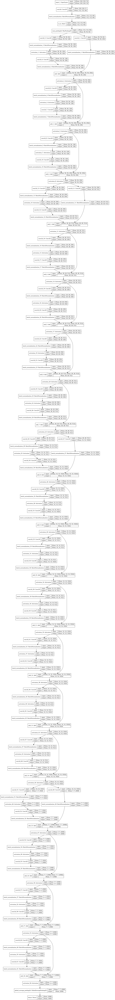

In [10]:
tf.keras.backend.clear_session()

inputs = layers.Input(shape=(224, 224, 3))

# stem
x = layers.Conv2D(filters=64, kernel_size=(7,7), strides=2, padding='same')(inputs)
x = layers.BatchNormalization()(x)
x = layers.ReLU()(x)
x = layers.MaxPool2D(pool_size=3, strides=2, padding='same')(x)

# Stage 1, 3 blocks
x = projection_block(x, 128)

for _ in range(2):
    x = identity_block(x, 128)

# Stage 2, 4 blocks
x = projection_block(x, 256, 2)
for _ in range(4):
    x = identity_block(x, 256)

# Stage 3, 6 blocks
x = projection_block(x, 512, 2)
for _ in range(6):
    x = identity_block(x, 512)

# Stage 4, 3 blocks
x = projection_block(x, 1024, 2)
for _ in range(3):
    x = identity_block(x, 1024)

# classification head
x = layers.GlobalAveragePooling2D()(x)
outputs = layers.Dense(units=1000, activation='softmax')(x)


resnext = tf.keras.Model(inputs, outputs, name="resnext_50")

resnext.summary()
utils.plot_model(resnext, show_shapes=True, to_file="resnext_50.png")

# Xception <span id="xception">[2017]</span>

[Xception: Deep Learning with Depthwise Separable Convolutions](https://arxiv.org/pdf/1610.02357.pdf)

Xception is based on InceptionV3 but instead of using inception modules, it uses depthwise separable convolutions. As results, it's efficient and it performs much better with the same number of parameters as Inception V3.

Depthwise separable convolutions, also called depthwise convolutions perform independently over each channel of the input image, concatenate and apply 1x1 convolution(also called pointwise convolution) to the results. It's like learning the spatial features of each image channel before mixing their output channels together with 1x1 convolutions.

In [11]:
def entry_flow(input):
    """
    Entry flow is the first block of Xception architecture
    input: input image of shape (299, 299, 3)
    """

    x = layers.Conv2D(filters=32, kernel_size=(3,3), strides=2, padding='same')(input)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(filters=64, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    shortcut = layers.Conv2D(filters=128, kernel_size=(1,1), strides=2, padding='same')(x)
    shortcut = layers.BatchNormalization()(shortcut)

    x = layers.SeparableConv2D(filters=128, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.SeparableConv2D(filters=128, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(x)

    x = layers.Add()([x, shortcut])

    shortcut = layers.Conv2D(filters=256, kernel_size=(1,1), strides=2, padding='same')(x)
    shortcut = layers.BatchNormalization()(shortcut)

    x = layers.ReLU()(x)
    x = layers.SeparableConv2D(filters=256, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.SeparableConv2D(filters=256, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(x)

    x = layers.Add()([x, shortcut])

    shortcut = layers.Conv2D(filters=728, kernel_size=(1,1), strides=2, padding='same')(x)
    shortcut = layers.BatchNormalization()(shortcut)

    x = layers.ReLU()(x)
    x = layers.SeparableConv2D(filters=728, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.SeparableConv2D(filters=728, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(x)

    output_tensor = layers.Add()([x, shortcut])

    return output_tensor


def middle_flow(input_tensor):
    """
    Middle flow of the Xception Architecture
    input_tensor: output tensor of the the entry flow
    Middle flow will be repeated 8 times.
    """
    shortcut = input_tensor

    x = layers.ReLU()(input_tensor)
    x = layers.SeparableConv2D(filters=728, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)

    x = layers.ReLU()(x)
    x = layers.SeparableConv2D(filters=728, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)

    x = layers.ReLU()(x)
    x = layers.SeparableConv2D(filters=728, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)

    x = layers.Add()([x, shortcut])

    return x


def exit_flow(input_tensor):
    """
    Exit flow of Xception architecture
    input_tensor: output tensor of the middle flow
    Fully connected layers before classification layer are optional
    """

    shortcut = layers.Conv2D(filters=1024, kernel_size=(1,1), strides=2, padding='same')(input_tensor)
    shortcut = layers.BatchNormalization()(shortcut)

    x = layers.ReLU()(input_tensor)
    x = layers.SeparableConv2D(filters=728, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.SeparableConv2D(filters=1024, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D(pool_size=3, strides=2, padding='same')(x)
    x = layers.Add()([x, shortcut])

    x = layers.SeparableConv2D(filters=1536, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.SeparableConv2D(filters=2048, kernel_size=(3,3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.GlobalAveragePooling2D()(x)
    classifier = layers.Dense(1000, activation='softmax')(x)

    return classifier

Model: "xception"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 150, 150, 32) 896         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 150, 150, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
re_lu (ReLU)                    (None, 150, 150, 32) 0           batch_normalization[0][0]        
___________________________________________________________________________________________

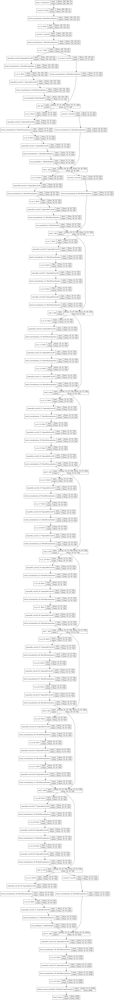

In [12]:
tf.keras.backend.clear_session()

inputs = layers.Input(shape=(299,299,3))

x = entry_flow(inputs)

for _ in range(8):
    x = middle_flow(x)

output = exit_flow(x)

xception = tf.keras.Model(inputs, output, name="xception")

xception.summary()
utils.plot_model(xception, show_shapes=True, to_file="xception.png")

# DenseNet <span id="dense-net">[2017]</span>

[Densely Connected Convolutional Networks](https://arxiv.org/pdf/1608.06993v5.pdf)

Skip connections are a pretty cool idea. Why don’t we just skip-connect everything?

Densenet is an example of pushing this idea into the extremity. Of course, the main difference with ResNets is that we will concatenate instead of adding the feature maps.

In [13]:
def dense_block(input_tensor, k, block_reps):
    """
    tensor: input tensor from the previous layers
    k: growth rate
    block_reps: Number of times the block is repeated
    Return the concatenated tensors
    """
    for _ in range(block_reps):

        x = layers.BatchNormalization()(input_tensor)
        x = layers.ReLU()(x)
        x = layers.Conv2D(filters=4*k, kernel_size=1)(x)
        x = layers.BatchNormalization()(x)
        x = layers.ReLU()(x)
        x = layers.Conv2D(filters=k, kernel_size=3, padding='same')(x)

        output_tensor = layers.Concatenate()([input_tensor, x])

    return output_tensor

def transition_layers(input_tensor, theta=0.5):
    """
    input_tensor: tensor from the previous dense block
    theta: compression factor, to be multiplied to the output feature maps...
    of the previous dense block.
    return the output tensor
    """

    filters = input_tensor.shape[-1] * theta

    x = layers.BatchNormalization()(input_tensor)
    x = layers.ReLU()(x)
    x = layers.Conv2D(filters=filters, kernel_size=1)(x)
    output_tensor = layers.AveragePooling2D(pool_size=2, strides=2)(x)

    return output_tensor

Model: "densenet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 224, 224, 3)  12          input_1[0][0]                    
__________________________________________________________________________________________________
re_lu (ReLU)                    (None, 224, 224, 3)  0           batch_normalization[0][0]        
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 109, 109, 64) 9472        re_lu[0][0]                      
___________________________________________________________________________________________

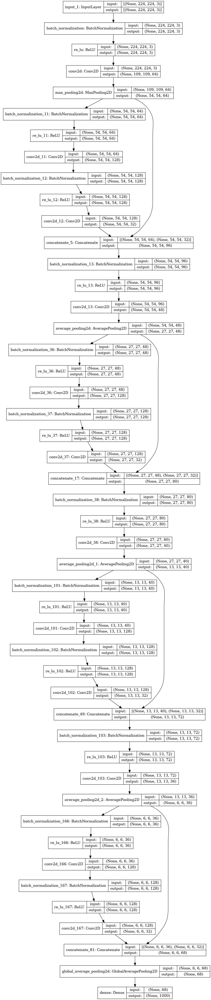

In [14]:
tf.keras.backend.clear_session()

k = 32 #growth rate

inputs = layers.Input(shape=(224,224,3))
x = layers.BatchNormalization()(inputs)
x = layers.ReLU()(x)
x = layers.Conv2D(filters=2*k, kernel_size=7, strides=2)(x)
x = layers.MaxPooling2D(pool_size=3, strides=2)(x)

x = dense_block(x, 32, 6)
x = transition_layers(x)

x = dense_block(x, 32, 12)
x = transition_layers(x)

x = dense_block(x, 32, 32)
x = transition_layers(x)

x = dense_block(x, 32, 32)

x = layers.GlobalAveragePooling2D()(x)
output = layers.Dense(1000, activation='softmax')(x)

densenet = tf.keras.Model(inputs, output, name="densenet")

densenet.summary()
utils.plot_model(densenet, show_shapes=True, to_file="densenet.png")

# MobileNetV1 <span id="mobile-net-v1">[2017]</span>

[MobileNets: Efficient Convolutional Neural Networks for Mobile Vision Applications](https://arxiv.org/pdf/1704.04861v1.pdf)

MobileNets uses depthwise separable convolutions which  are special type of grouped convolutions that performs spatial convolutions on each independent channel, concatenate the results and apply 1x1 convolution(pointwise) to the results.

A Depthwise separable convolution is essentially made of depthwise(channel-wise) convolution and 1x1 convolution(point wise convolution). Depthwise or channel wise convolution applies a single filter to each input channel. Depthwise convolution is also similar to standard convolution whose groups are equal to the number of channels/filters. The pointwise or 1x1 convolution is used to combine the outputs of depthwise convolution layer. In essence, 1x1 convolution is equivalent to a fully connected layer(linear layer).

Depthwise separable convolution is simply the combination of depthwise or channel wise convolution and 1x1 convolution.

In [15]:
def depthwise_block(input, filters, strides, padding='same'):
    """
    3x3 depthwise conv - batchnorm - relu - 1x1 conv - batchnorm - relu block

    Arguments:
    ---------
    input: input tensor
    filters: no of filters in depthwise convolution
    strides: no of strides in depthwise convolution
    padding: padding option in depthwise convolution
    """
    x = layers.DepthwiseConv2D(kernel_size=3, strides=strides, padding=padding)(input)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(filters=filters, kernel_size=1, strides=1, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    return x

Model: "mobilenet"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 112, 112, 32)      896       
_________________________________________________________________
batch_normalization (BatchNo (None, 112, 112, 32)      128       
_________________________________________________________________
re_lu (ReLU)                 (None, 112, 112, 32)      0         
_________________________________________________________________
depthwise_conv2d (DepthwiseC (None, 112, 112, 32)      320       
_________________________________________________________________
batch_normalization_1 (Batch (None, 112, 112, 32)      128       
_________________________________________________________________
re_lu_1 (ReLU)               (None, 112, 112, 32)      0 

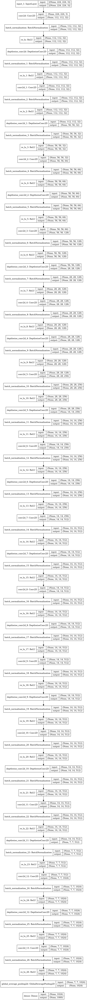

In [16]:
tf.keras.backend.clear_session()

inputs = layers.Input(shape=(224, 224, 3))

#input downsampling stem
x = layers.Conv2D(filters=32, kernel_size=3, strides=2, padding='same')(inputs)
x = layers.BatchNormalization()(x)
x = layers.ReLU()(x)

# depthwise separable convolutions blocks
x = depthwise_block(x, filters=32, strides=1)
x = depthwise_block(x, filters=64, strides=2)
x = depthwise_block(x, filters=128, strides=1)
x = depthwise_block(x, filters=128, strides=2)
x = depthwise_block(x, filters=256, strides=1)
x = depthwise_block(x, filters=256, strides=2)

# 5 repeated depthwise seperable conv blocks
for _ in range(5):
    x = depthwise_block(x, filters=512, strides=1)

x = depthwise_block(x, filters=1024, strides=2)
x = depthwise_block(x, filters=1024, strides=1)

# classification head
x = layers.GlobalAveragePooling2D()(x)
output = layers.Dense(units=1000, activation='softmax')(x)

mobilenet = tf.keras.Model(inputs, output, name="mobilenet")

mobilenet.summary()
utils.plot_model(mobilenet, show_shapes=True, to_file="mobilenet.png")

# MobileNetV2 <span id="mobile-net-v2">[2018]</span>

[MobileNetV2: Inverted Residuals and Linear Bottlenecks](https://arxiv.org/pdf/1801.04381.pdf)

 MobileNetV2 is an improved version of MobileNetV1 and it is based on the inverted residual blocks with depthwise convolutions as intermediate layer in the inverted residual blocks.

In [17]:
def inverted_res_block(input, in_channels, out_channels, t, strides):
    """
    Arugments:
    ---------
    input: input tensor
    in_channels: number of channels from the previous tensor(input)
    out_channels: number of output channels in the conv block
    t: the expansion rate, t = 1 for the first bottleneck, t = 6 for other bottlenecks
    strides: strides in 3x3 depthwise convolution, strides=1 as there is a shortcut.

    -------
    notes on strides: the first residual block in blocks has stride s and other has stride 1
    """

    x = layers.Conv2D(filters=in_channels * t, kernel_size=1, strides=1, padding='same')(input)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.DepthwiseConv2D(kernel_size=3, strides=strides, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(filters=out_channels, kernel_size=1, strides=1, padding='same', activation=None)(x)
    x = layers.BatchNormalization()(x)

    # if the strides in depthwise conv is 1, add identity shortcut
    if strides == 1 and in_channels == out_channels:
        shortcut = input
        x = layers.Add()([x, shortcut])

    return x

Model: "mobilenet_v2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 112, 112, 32)      896       
_________________________________________________________________
batch_normalization (BatchNo (None, 112, 112, 32)      128       
_________________________________________________________________
re_lu (ReLU)                 (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 112, 112, 32)      1056      
_________________________________________________________________
batch_normalization_1 (Batch (None, 112, 112, 32)      128       
_________________________________________________________________
re_lu_1 (ReLU)               (None, 112, 112, 32)     

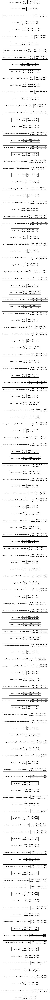

In [18]:
tf.keras.backend.clear_session()

inputs = layers.Input(shape=(224, 224, 3))

x = layers.Conv2D(filters=32, kernel_size=3, strides=2, padding='same')(inputs)
x = layers.BatchNormalization()(x)
x = layers.ReLU()(x)

x = inverted_res_block(x, 32, 16 , t=1, strides=1)

x = inverted_res_block(x, 16, 24, t=6, strides=2)
x = inverted_res_block(x, 16, 24, t=6, strides=1)

x = inverted_res_block(x, 24, 32, t=6, strides=2)
x = inverted_res_block(x, 24, 32, t=6, strides=1)
x = inverted_res_block(x, 24, 32, t=6, strides=1)

x = inverted_res_block(x, 32, 64, t=6, strides=2)
x = inverted_res_block(x, 32, 64, t=6, strides=1)
x = inverted_res_block(x, 32, 64, t=6, strides=1)
x = inverted_res_block(x, 32, 64, t=6, strides=1)

x = inverted_res_block(x, 64, 96, t=6, strides=1)
x = inverted_res_block(x, 64, 96, t=6, strides=1)
x = inverted_res_block(x, 64, 96, t=6, strides=1)


x = inverted_res_block(x, 96, 160, t=6, strides=2)
x = inverted_res_block(x, 96, 160, t=6, strides=1)
x = inverted_res_block(x, 96, 160, t=6, strides=1)

x = inverted_res_block(x, 160, 320, t=6, strides=1)

x = layers.Conv2D(filters=1280, kernel_size=1, strides=1, padding='same')(x)
x = layers.BatchNormalization()(x)
x = layers.ReLU()(x)
x = layers.GlobalAveragePooling2D()(x)
output = layers.Dense(1000, activation='softmax')(x)

mobilenetv2 = tf.keras.Model(inputs, output, name="mobilenet_v2")

mobilenetv2.summary()
utils.plot_model(mobilenetv2, show_shapes=True, to_file="mobilenetv2.png")

# EfficientNet <span id="efficient-net">[2012]</span>

[EfficientNet: Rethinking Model Scaling for Convolutional Neural Networks](https://arxiv.org/pdf/1905.11946v5.pdf)

EfficientNets is a family of ConvNets that achieves better accuracy and efficiency than most previous ConvNets.

EfficientNet demonstrates that it is possible to effectively scale both width, depth and resolution and hence introducing a scaling method called compound scaling method. The depth, width, and the resolution of the image can be scaled by fixed scaling coefficients.

Compound scaling makes sense because if the input image is bigger, the network needs more layers(representing depth) to increase the receptive fields and more channels(representing width) to capture more representations.

Scaling depth d is the most common scaling method in ConvNets architectures design. Deer ConvNets are able to capture richer and complex features and have high generalization ability. The downside of deeper networks is that they hard to train due to vanishing gradient problem although techniques like batch normalization and skip connections can help reduce the training problems. Very deep networks provides diminishing accuracy for higher depths.

Scaling width w is mostly used in small size models. Just like deeper networks, wider networks can capture richer representations but they are easier to train compared to deeper networks. There is also a trend here: wider but shallow networks can fail to capture high-level features from the image and the accuracy quickly saturates when networks become much wider.

Scaling the resolution r of input image can also helps the ConvNets to capture richer representations. ConvNets with higher resolutions such as 480x480 achieved state of the art results on ImageNet. Higher resolutions such as 600x600 are also used in object detection. But similar to the behavior of large width and depth, extreme resolutions diminishes accuracy.

In [19]:
def mbconv_block(input, filters_in, filters_out, kernel_size=3, strides=1, exp_ratio=6, se_ratio=0.25):
    """
    Arguments:
    -------
    input: input tensor
    filters_in: input filters
    filters_out: output filters
    kernel_size: the size/dimension of convolution filters
    strides: integer, the stride of convolution. If strides=2, padding in depthwise conv is 'valid'.
    exp_ratio: expansion ration, an integer for scaling the input filters/filters_in
    se_ratio: a float between 0 and 1 for squeezing the input filters
    -------
    """

    # Expansion layer: exp_ratio is integer >=1

    filters = filters_in * exp_ratio
    if exp_ratio != 1:
        x = layers.Conv2D(filters, kernel_size=1, padding='same')(input)
        x = layers.BatchNormalization()(x)
        x = tf.keras.activations.swish(x)

    else:
        x = input

    # Depthwise convolution
    x = layers.DepthwiseConv2D(kernel_size=kernel_size, strides=strides, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = tf.keras.activations.swish(x)

    # Squeeze and excitation
    if se_ratio > 0 and se_ratio <= 1:
        filters_se = max(1, int(filters_in * se_ratio)) #max with 1 to make sure filters are not less than 1
        se = layers.GlobalAveragePooling2D()(x)
        se = layers.Reshape((1, 1, filters))(se)
        se = layers.Conv2D(filters_se, kernel_size=1, padding='same', activation='swish')(se)
        se = layers.Conv2D(filters, kernel_size=1, padding='same', activation='sigmoid')(se)
        x = layers.multiply([x, se])

    x = layers.Conv2D(filters_out, kernel_size=1, padding='same')(x)
    x = layers.BatchNormalization()(x)

    # Add identity shortcut if strides=2 and in & filters are same
    if strides == 1 and filters_in == filters_out:
        x = layers.add([x, input])

    return x

def scale_number_of_blocks(block_repeats, depth_coefficient=1):
    """Scale and round the number of block repeatitions(scale depth in other words)"""
    scaled_blocks = int(math.ceil(block_repeats * depth_coefficient))
    return scaled_blocks

def scale_width(filters, width_coefficient=1, depth_divisor=8):
    filters *= width_coefficient
    new_filters = (filters + depth_divisor / 2) // depth_divisor * depth_divisor
    new_filters = max(depth_divisor, new_filters)

    # make sure that scaled filters down does not go down by more than 10%
    if new_filters < 0.9 * filters:
        new_filters += depth_divisor

    return int(new_filters)

In [20]:
tf.keras.backend.clear_session()

input_shape = (224, 224, 3)

# If using the scaling utility functions, use the following hyperparamaters for EfficientNet-B0
# depth_coefficient = 1.0
# width_coefficient = 1.0
# depth_divisor = 8

# The stem of network
inputs = layers.Input(input_shape)
x = layers.Conv2D(filters=32, kernel_size=3, strides=2, padding='same')(inputs)
x = layers.BatchNormalization()(x)
x = tf.keras.activations.swish(x)

# MBConv blocks
# Block 1: input filters=32, output filters=16, kernel size=3, block repeats=1
x = mbconv_block(x, filters_in=32, filters_out=16, kernel_size=3, strides=1, exp_ratio=1)

# Block 2: input filters=16, output filters=24, kernel size=3, strides=2, block repeats=2
# the first block of every stage has stride of 1
x = mbconv_block(x, filters_in=16, filters_out=24, kernel_size=3, strides=1, exp_ratio=6)
x = mbconv_block(x, filters_in=16, filters_out=24, kernel_size=3, strides=2, exp_ratio=6)

# Block 3: input filters=24, output filters=40, kernel size=5, strides=2, block repeats=2 
x = mbconv_block(x, filters_in=24, filters_out=40, kernel_size=5, strides=1, exp_ratio=6)
x = mbconv_block(x, filters_in=24, filters_out=40, kernel_size=5, strides=2, exp_ratio=6)

# Block 4: input filters=40, output filters=80, kernel size=3, strides=2, block repeats=3
x = mbconv_block(x, filters_in=40, filters_out=80, kernel_size=3, strides=1, exp_ratio=6)
x = mbconv_block(x, filters_in=40, filters_out=80, kernel_size=3, strides=2, exp_ratio=6)
x = mbconv_block(x, filters_in=40, filters_out=80, kernel_size=3, strides=2, exp_ratio=6)
x = mbconv_block(x, filters_in=40, filters_out=80, kernel_size=3, strides=2, exp_ratio=6)

# Block 5: input filters=80, output filters=112, kernel size=5, strides=1, block repeats=3
x = mbconv_block(x, filters_in=80, filters_out=112, kernel_size=5, strides=1, exp_ratio=6)
x = mbconv_block(x, filters_in=80, filters_out=112, kernel_size=5, strides=1, exp_ratio=6)
x = mbconv_block(x, filters_in=80, filters_out=112, kernel_size=5, strides=1, exp_ratio=6)

# Block 6: input filters=112, output filters=192, kernel size=5, strides=2, block repeats=4
x = mbconv_block(x, filters_in=112, filters_out=192, kernel_size=5, strides=1, exp_ratio=6)
x = mbconv_block(x, filters_in=112, filters_out=192, kernel_size=5, strides=2, exp_ratio=6)
x = mbconv_block(x, filters_in=112, filters_out=192, kernel_size=5, strides=2, exp_ratio=6)
x = mbconv_block(x, filters_in=112, filters_out=192, kernel_size=5, strides=2, exp_ratio=6)

# Block 7: input filters=192, output filters=320, kernel size=3, strides = 1, block repeats=1
x = mbconv_block(x, filters_in=192, filters_out=320, kernel_size=3, strides=1, exp_ratio=6)

# Classification head
x = layers.Conv2D(filters=1280, kernel_size=1, padding='same')(x)
x = layers.BatchNormalization()(x)
x = tf.keras.activations.swish(x)
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dropout(0.2)(x)
output = layers.Dense(units=1000, activation='softmax')(x)

efficientnet_b0 = tf.keras.Model(inputs=inputs, outputs=output, name="efficientnet_b0")

efficientnet_b0.summary()
utils.plot_model(efficientnet_b0, show_shapes=True, to_file="efficientnet_b0.png")

Model: "efficientnet_b0"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 112, 112, 32) 896         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 112, 112, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
tf.nn.silu (TFOpLambda)         (None, 112, 112, 32) 0           batch_normalization[0][0]        
____________________________________________________________________________________

# RegNet <span id="reg-net">[2020]</span>

[Designing Network Design Spaces](https://arxiv.org/pdf/2003.13678.pdf)

The principal idea behind RegNet is discovering network design principles that can generalize across different settings rather than finding a single best network that only works in one specific settings.

The authors define design space as a large, possibly infinite, population of model architectures.

AnyNet is the basic network in the design space. It contains a stem(3x3 conv with stride 2 and 32 filters), the network body (or convolution blocks) that performs the bulk of computations and final classification head(average pooling layer and fully connected layer with softmax activation) that predicts the output classes.

By just changing network width(number of channels), depth(number of convolutional blocks), channel width and bottleneck width, one can arrive at vast number of efficient networks that the authors termed as AnyNets and RegNets (there are so many version of those networks that only differ in sizes).

The stem is fixed across different version of AnyNets and RegNets. It's 3x3 convolution with strides of 2 and 32 filters/channels. The body of the network is made of convolution blocks that do major computations. The blocks are based on the standard residual bottleneck block with grouped convolutions. Each block contains 1x1 conv or pointwise convolution, 3x3 grouped conv, and a final 1x1 conv for restoring/reducing dimension. Each convolution layer is followed by batch normalization and ReLU.

In [21]:
def stem(input):
    """
    stem of RegNetX032(same for other networks)
    input: input tensor
    """
    x = layers.Conv2D(filters=32, kernel_size=3, strides=2, padding='same')(input)
    x = layers.BatchNormalization(epsilon=1e-5)(x)
    x = layers.ReLU()(x)

    return x

def conv_block(input, filters_out, group_width=48, strides=1):
    """
    RegNetX-032 block (RegNetX blocks don't have squeeze and excitation)

    input: input tensor
    filters_out: output filters
    group_width: group widths in grouped convolutions
    strides: strides in grouped convolution. 

    If strides=1, we add identity shortcut from input to output. 
    If strides=2, the shortcut has 1x1 conv with strides 2.
    """

    groups = filters_out // group_width

    x = layers.Conv2D(filters=filters_out, kernel_size=1, strides=1)(input)
    x = layers.BatchNormalization(epsilon=1e-5)(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(filters=filters_out, kernel_size=3, strides=strides, groups=groups, padding='same')(x)
    x = layers.BatchNormalization(epsilon=1e-5)(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(filters=filters_out, kernel_size=1, strides=1)(x)
    x = layers.BatchNormalization(epsilon=1e-5)(x)
    x = layers.ReLU()(x)

    if strides == 1:
        shortcut = input
        x = layers.Add()([x, shortcut])
  
    if strides == 2:
        shortcut = layers.Conv2D(filters=filters_out, kernel_size=1, strides=strides)(input)
        shortcut = layers.BatchNormalization(epsilon=1e-5)(shortcut)
        x = layers.Add()([x, shortcut])

    return x

Model: "regnetx_032"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 112, 112, 32) 896         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 112, 112, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
re_lu (ReLU)                    (None, 112, 112, 32) 0           batch_normalization[0][0]        
________________________________________________________________________________________

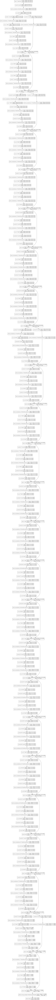

In [22]:
tf.keras.backend.clear_session()

input_shape = (224, 224, 3)

inputs = layers.Input(shape=input_shape)

# Stem
x = stem(inputs)

# RegNetX032 blocks
# Each stage has number of blocks n where the first block of each stage has stride of 2 in grouped convolution

# stage 1: 2 blocks, 96 channels(filters_out)
x = conv_block(x, 96, group_width=48, strides=2)
x = conv_block(x, 96, group_width=48, strides=1)

# stage 2: 6 blocks, 192 channels(filters_out)
x = conv_block(x, 192, group_width=48, strides=2)
for _ in range(1, 6):
    x = conv_block(x, 192, group_width=48, strides=1)

# stage 3: 15 blocks, 432 channels(filters_out)
x = conv_block(x, 432, group_width=48, strides=2)
for _ in range(1, 15):
    x = conv_block(x, 432, group_width=48, strides=1)

#stage 4: 2 blocks, 1008 channels(filters_out)
x = conv_block(x, 1008, group_width=48, strides=2)
x = conv_block(x, 1008, group_width=48, strides=1)

# classification head
x = layers.GlobalAveragePooling2D()(x)
output = layers.Dense(units=1000, activation='softmax')(x)

#build the model
regnetx_032 = tf.keras.Model(inputs=inputs, outputs=output, name="regnetx_032")

regnetx_032.summary()
utils.plot_model(regnetx_032, show_shapes=True, to_file="regnetx_032.png")

# ConvMixer <span id="conv-mixer">[2022]</span>

[Patches Are All You Need](https://openreview.net/pdf?id=TVHS5Y4dNvM)

ConvMixer is an extremely simple architecture that directly operates on image patches like Visual Transformers. The intent of the paper is to study if the extreme performance of Visual Transformers is due to inherent scaling behavior of transformers or if it is due to operating images patches as input representations!

ConvMixer is made of 3 main parts:
 
 * The first and most important part is a patch embedding layer that can be implemented with normal convolutional layer with input channels `ci`, output channels `h`, strides `s`, and kernel size `k`. All convolutions layers are followed by GELU non-linearity and batch normalization.
 
 * The second important part is ConvMixer block that is made of depthwise convolutions(grouped convolution with groups equal to the number of channels) and pointwise convolutions(or 1x1 convolutions). ConvMixer block is repeated `depths` times. 
 
 * The third part is classification head that contains global average pooling layer and fully connected layer with softmax activation.
 
ConvMixer block is made of four main parameters that are:
 
 * The width or hidden dimension `h` or the dimensions or number of output channels in input convolution layer that produces patche embeddings.
 * The depth `d` or number of ConvMixer blocks repeated across the network.
 * The patch size `p` that controls the internal resolution(or the resolution of intermediate representations) of the model.
 * The kernel size `k` in depthwise convolutions layer.
 
ConvMixer is named after the width `h` and depth `d` and is based on the idea of mixing (as is in [MLP-Mixer](https://arxiv.org/pdf/2105.01601.pdf)) - depthwise convolutions mix `spatial locations` and pointwise convolutions(or 1x1 conv) mix `channel locations`.


In [23]:
def convmixer_block(input, filters, kernel_size):
    """
    Input params
    ------
    input: input tensor
    filters: the number of output channels or filters in pointwise convolution
    kernel_size: kernel_size in depthwise convolution
    """
    shortcut = input

    # Depthwise convolution
    x = layers.DepthwiseConv2D(kernel_size=kernel_size, padding='same')(input)
    x = tf.keras.activations.gelu(x)
    x = layers.BatchNormalization()(x)

    # Shortcut connection
    x = layers.Add()([shortcut, x])

    # Pointwise or 1x1 convolution
    x = layers.Conv2D(filters=filters, kernel_size=1, padding='same')(x)
    x = tf.keras.activations.gelu(x)
    x = layers.BatchNormalization()(x)

    return x


Model: "convmixer"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 1536) 227328      input_1[0][0]                    
__________________________________________________________________________________________________
tf.nn.gelu (TFOpLambda)         (None, 32, 32, 1536) 0           conv2d[0][0]                     
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 1536) 6144        tf.nn.gelu[0][0]                 
__________________________________________________________________________________________

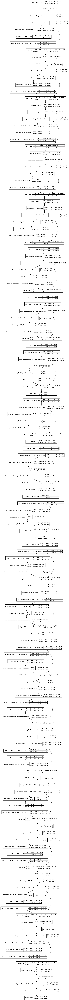

In [24]:
tf.keras.backend.clear_session()

input_shape = (224, 224, 3) 
patch_size = 7
depth = 20
kernel_size = 9
filters = 1536
num_classes = 1000 #per imagenet

# Input and patch embedding layer
inputs = layers.Input(input_shape)
x = layers.Conv2D(filters=filters, kernel_size=patch_size, strides=patch_size)(inputs)
x = tf.keras.activations.gelu(x)
x = layers.BatchNormalization()(x)

# ConvMixer blocks repeated depth times
for _ in range(depth):
    x = convmixer_block(x, filters, kernel_size)

# Classification head
x = layers.GlobalAveragePooling2D()(x)
output = layers.Dense(units=num_classes, activation='softmax')(x)

convmixer = tf.keras.Model(inputs=inputs, outputs=output, name="convmixer")

convmixer.summary()
utils.plot_model(convmixer, show_shapes=True, to_file="convmixer.png")

# ConvNext <span id="conv-next">[2022]</span>

[A ConvNet for the 2020s](https://arxiv.org/pdf/2201.03545.pdf)

The central idea of the paper is to investigate and to follow the levels of designs of Swin Transformer while maintaining the simplicity of standard ConvNets such as ResNet. In other words, ConvNeXt seeks to imitate the design features that makes Swin Transformers great and apply them on standard ConvNets.

The authors present their full roadmap with clear and experimented results. Here we will review the high-level takes from what they found: 

* Their **baseline** was ResNet-50 trained on ImageNet with vision transformers training techniques. 
* They used the **Swin transformer training techniques** such as AdamW optimizer and different data augmentation techniques like [Mixup](https://paperswithcode.com/method/mixup), [CutMix](https://paperswithcode.com/method/cutmix), [randaugment](https://paperswithcode.com/method/randaugment), [random erasing](https://paperswithcode.com/method/random-erasing) and different regularization schemes such as [stochastic depth](https://paperswithcode.com/method/stochastic-depth) and [label smoothing](https://paperswithcode.com/method/label-smoothing).

* **Changing the stage compute ratio**: The orginal ResNet-50 used stage ratio of (3,4,6,3). Stage ratio are the number of resnet blocks in each stage. Learning from Swin Transformer that uses stage ratio of (1:1:3:1 and 1:1:9:1 for large transformers), ConvNeXt uses stage ratio of (3,3,9,3). That change improves accuracy and computation efficiency. 

* **Changing stem to `patchify`:** The stem block or input downsampling block of ResNet contains 7x7 convolution with strides of 2 followed by maxpool. Swin Transformer uses a patchify layer with a patch size of 4. ConvNeXt implements a patchify layer using 4x4, stride 4 convolution layer. That also improves the accuracy.

* **Using depthwise convolution**: Inspired by ResNeXt that used grouped convolution, ConvNeXt uses a 7x7 depthwise convolution in ConvNeXt blocks. Depthwise convolution is a special type of grouped convolution where the number of groups equal the number of channels. Depthwise convolutions have been previously used in notable architectures such as [MobileNet](https://arxiv.org/pdf/1704.04861v1.pdf) and Francois Chollet's [Xception](https://arxiv.org/abs/1610.02357). Using depthwise convolution effectively reduces the FLOPS(floating points) (and accuracy), but there is an arguments that it doesn't such as [this](https://twitter.com/giffmana/status/1481553232400949251) and [this](https://twitter.com/ChrSzegedy/status/1481578727242825728).


* **Using inverted bottlenecks blocks:** Every transformer block creates inverted block. ConvNeXt learnt from that and that resulted in improved accuracy and even fewer parameters/reduced network FLOPs. 

* **Replacing ReLU with GELU:** [GELU](https://arxiv.org/abs/1606.08415v4) standing for Gaussian Error Linear Unit has been used in Vision Transformers(ViT) and other transformer-based language models such as BERT and GPT-2. Replacing it with ReLU didn't change the accuracy but the author opted to use it since their mere goal was to mimic the design of vision transformers to CNNs in hope of improvement. Replacing ReLU with GeLU is trading the simplicity without a gain, Karpathy [said](https://twitter.com/karpathy/status/1481724509795221505?s=20).

* **Replacing batch normalization with layer normalization:** Batch normalization is an essential component of ConvNets because it helps the network to converge faster and reduces overfitting. But how batch normalization works is not clearly understood. Because layer normalization is mostly used in transformers, the authors decided to replace it with layer normalization but they only used one normalization layer in residual block.

* **Using fewer activation functions and fewer normalization layers:** Every convolution layer in ResNet's residual blocks was followed by normalization and activation layer. On the other hand, transformers use fewer activations functions and normalization layers. The authors also learned from transformers and used only one GELU activation between two pointwise convolutions(1x1 conv) and also used a single normalization layer before the first 1x1 conv in each residual block.

* **Using separate downsampling layers**: In ResNet, the spatial downsampling is achieved by the residual block at the start of each stage using 3x3 conv with stride 2 and a shortcut connection of 1x1 conv with stride of 2. Transformers uses a separate downsampling layer. ConvNeXt replicated that and rather than using ResNet downsampling strategy, it used a separate downsampling layers. The downsampling layers in ConvNeXt are layer normalization followed by normal 2x2 convolution with strides of 2 and are inserted between stages. The stem network(7x7 depthwise conv and layer normalization) comes above the first stage, but then between the all following stages, there are downsampling layers.

In [25]:
def convnext_block(inputs, dim, drop_path=0.0):
    """
    ConvNeXt Block

    Input Parameters:

    input: input tensor
    dim: Number of filters/channels
    drop_path: Set to 0 by default
    ----------------------

    About the block:
    - 7x7 depthwise conv(can be implemented from Conv2D, no of groups = no of filters)
    - 2 1x1 convs or pointwise layers are equivalent to dense layers(or fully connected layer) operating independently on each channel
    - The number of channels in the first 1x1 conv is 4 times the input dimension.
    - The channels for the last 1x1 conv are similar to input channels. See the block.
    - Layer normalization layer comes before the first 1x1 conv
    - GELU layer is inserted between two 1x1 convs
    - There is a direct shortcut from the input of the block to the output
    """
    shortcut = inputs #shortcut connection
    x = layers.Conv2D(filters=dim, kernel_size=7, padding='same', groups=dim)(inputs)
    x = layers.LayerNormalization(epsilon=1e-6)(x)
    x = layers.Dense(4 * dim)(x)
    x = layers.Activation('gelu')(x)
    x = layers.Dense(dim)(x)

    #Stochastic depth
    drop_depth = tfa.layers.StochasticDepth(drop_path) if drop_path > 0.0 else layers.Activation("linear")
    output = layers.Add()([shortcut, drop_depth(x)])

    return output

def stem(inputs, dim):
    x = layers.Conv2D(filters=dim, kernel_size=4, strides=4)(inputs)
    x = layers.LayerNormalization(epsilon=1e-6)(x)
    return x

def downsampling_layers(inputs, dim):
    x = layers.LayerNormalization(epsilon=1e-6)(inputs)
    x = layers.Conv2D(filters=dim, kernel_size=2, strides=2)(x)
    return x

Model: "convnext"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 56, 56, 96)   4704        input_1[0][0]                    
__________________________________________________________________________________________________
layer_normalization (LayerNorma (None, 56, 56, 96)   192         conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 56, 56, 96)   4800        layer_normalization[0][0]        
___________________________________________________________________________________________

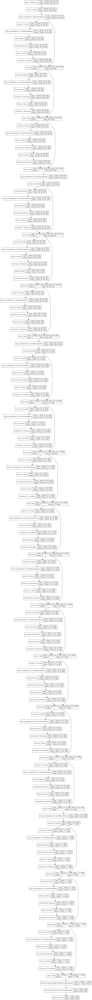

In [26]:
def convnext_model(input_shape=(224, 224, 3), dims=[96, 192, 384, 768], num_classes=1000):

    inputs = layers.Input(input_shape)

    # stem
    x = stem(inputs, dims[0])

    # Convnext stage 1 x3, dim[0] = 96
    for _ in range(3):
        x = convnext_block(x, dims[0])

    # Downsampling layers + stage 2 x3, dim[1] = 192
    x = downsampling_layers(x, dims[1])
    for _ in range(3):
        x = convnext_block(x, dims[1])

    # Downsampling layers + stage 3 x9, dim[2] = 384
    x = downsampling_layers(x, dims[2])
    for _ in range(9):
        x = convnext_block(x, dims[2])

    # Downsampling layers + stage 4 x3, dim[3] = 768
    x = downsampling_layers(x, dims[3])
    for _ in range(3):
        x = convnext_block(x, dims[3])
    
    # Classification head: Global average pool + layer norm + fully connected layer
    x = layers.GlobalAvgPool2D()(x)
    x = layers.LayerNormalization(epsilon=1e-6)(x)
    output = layers.Dense(units=num_classes, activation='softmax')(x)

    model = tf.keras.Model(inputs, output, name='convnext')

    return model

tf.keras.backend.clear_session()

convnext = convnext_model()
convnext.summary()
utils.plot_model(convnext, show_shapes=True, to_file="convnext.png")

Credits:
* [ModernConvNets](https://github.com/Nyandwi/ModernConvNets)
* [Best deep CNN architectures and their principles: from AlexNet to EfficientNet](https://theaisummer.com/cnn-architectures)